# Переворот спина методами кватового оптимального контроля

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import HTML

import qutip
from qutip import Qobj, identity, sigmax, sigmaz, sigmay, mesolve, basis
from qutip.control.pulseoptim import create_pulse_optimizer, optimize_pulse

In [2]:
import pathlib, sys

sys.path.append(str(pathlib.Path(sys.path[0]).parent / "libs"))

In [3]:
%reload_ext autoreload
%autoreload 2

import tools

In [4]:
n = 2  # фермионная система

In [5]:
t_total = 2
nt = 101
tlist = np.linspace(0, t_total, nt)

In [6]:
psi_initial = basis(n, 0)
psi_target = basis(n, 1)

## Эволюция под действием $\frac \pi 2 Sx$

Text(0, 0.5, '$F\\left(\\left|\\psi(\\tau)\\right\\rangle, |1\\rangle \\right)$')

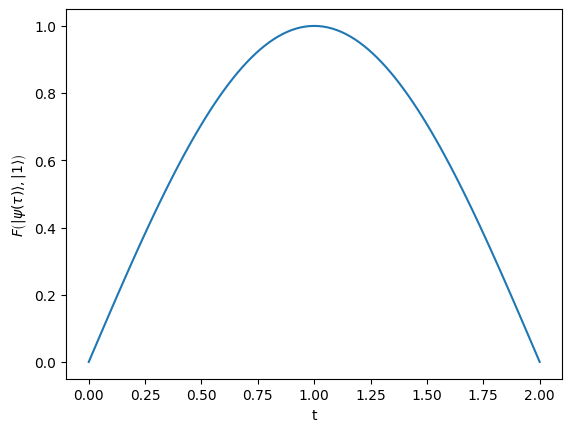

In [7]:
evolution_sx = mesolve(np.pi / 2 * sigmax(), psi_initial, tlist)

_, ax = plt.subplots(1)
ax.plot(
    evolution_sx.times,
    [qutip.metrics.fidelity(s, psi_target) for s in evolution_sx.states],
)
ax.set_xlabel("t")
ax.set_ylabel(r"$F\left(\left|\psi(\tau)\right\rangle, |1\rangle \right)$")

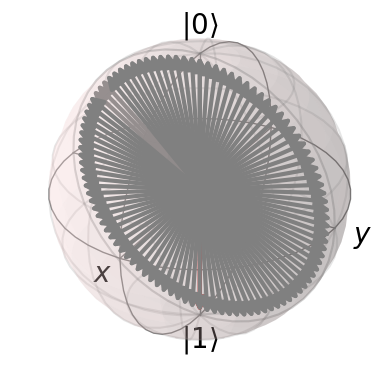

In [8]:
ani = tools.animate_state_evolution_on_bloch_sphere(evolution_sx, psi_target)
HTML(ani.to_jshtml())

## Эволюция с учетом зеймановской части $S_z + \frac \pi 2 Sx$

Text(0, 0.5, '$F\\left(\\left|\\psi(\\tau)\\right\\rangle, |1\\rangle \\right)$')

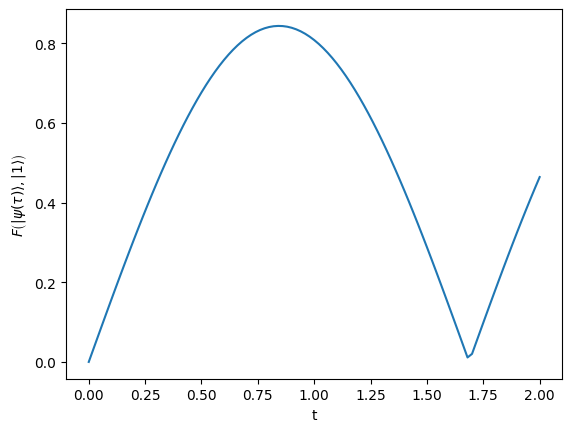

In [9]:
evolution_sx_and_sz = mesolve(np.pi / 2 * sigmax() + sigmaz(), psi_initial, tlist)

_, ax = plt.subplots(1)
ax.plot(
    evolution_sx_and_sz.times,
    [qutip.metrics.fidelity(s, psi_target) for s in evolution_sx_and_sz.states],
)
ax.set_xlabel("t")
ax.set_ylabel(r"$F\left(\left|\psi(\tau)\right\rangle, |1\rangle \right)$")

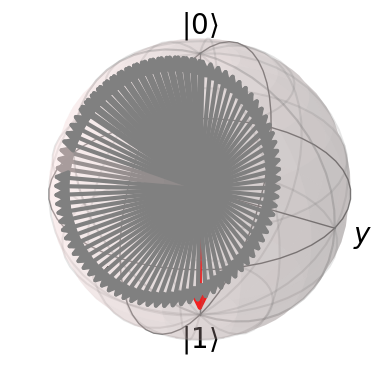

In [10]:
ani = tools.animate_state_evolution_on_bloch_sphere(evolution_sx_and_sz, psi_target)
HTML(ani.to_jshtml())

## Оптимизация гамильтониана $H_t = S_z + \alpha(t) \frac \pi 2 Sx$ для переворота спина

In [11]:
H0 = sigmaz()  # Гамильтониан без управления
H1 = sigmax()  # Гамильтониан управления

In [12]:
# Fidelity error target
fid_err_targ = 1e-10
# Maximum iterations for the optisation algorithm
max_iter = 500
# Maximum (elapsed) time allowed in seconds
max_wall_time = 30
# Minimum gradient (sum of gradients squared)
# as this tends to 0 -> local minima has been found
min_grad = 1e-20
# pulse type alternatives: RND|ZERO|LIN|SINE|SQUARE|SAW|TRIANGLE|
init_pulse_type = "SQUARE"

result = optimize_pulse(
    H0,
    [H1],
    psi_initial,
    psi_target,
    num_tslots=nt,
    evo_time=t_total,
    fid_err_targ=fid_err_targ,
    max_iter=max_iter,
    max_wall_time=max_wall_time,
    min_grad=min_grad,
    init_pulse_type=init_pulse_type,
    # dyn_type='SYMPL',
    gen_stats=True,
)

Отчет оптимизации

In [13]:
result.stats.report()


------------------------------------
---- Control optimisation stats ----
**** Timings (HH:MM:SS.US) ****
Total wall time elapsed during optimisation: 0:00:00.745605
Wall time computing Hamiltonians: 0:00:00.019486 (2.61%)
Wall time computing propagators: 0:00:00.632796 (84.87%)
Wall time computing forward propagation: 0:00:00.006722 (0.90%)
Wall time computing onward propagation: 0:00:00.006841 (0.92%)
Wall time computing gradient: 0:00:00.061248 (8.21%)

**** Iterations and function calls ****
Number of iterations: 130
Number of fidelity function calls: 147
Number of times fidelity is computed: 147
Number of gradient function calls: 147
Number of times gradients are computed: 147
Number of times timeslot evolution is recomputed: 147

**** Control amplitudes ****
Number of control amplitude updates: 146
Mean number of updates per iteration: 1.123076923076923
Number of timeslot values changed: 14746
Mean number of timeslot changes per update: 101.0
Number of amplitude values changed: 

Фиделити

In [14]:
result.fidelity

0.0

Text(0, 0.5, '$\\alpha(t)$')

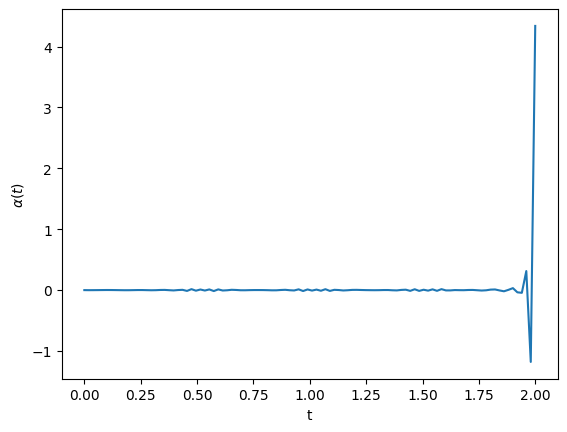

In [15]:
amps = np.insert(result.final_amps, 0, 0)

_, ax = plt.subplots()
ax.plot(result.time, amps)
ax.set_xlabel("t")
ax.set_ylabel(r"$\alpha(t)$")

Эволюция под действием оптимального гамильтониана

In [16]:
H_t = [H0, [H1, amps]]
evolution_optim = mesolve(H_t, psi_initial, result.time)

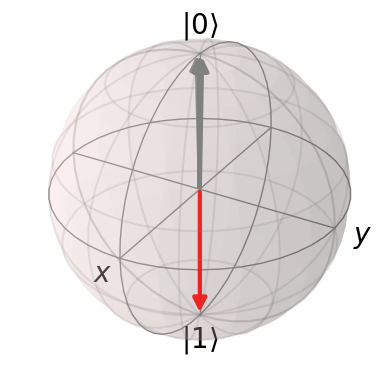

In [17]:
ani = tools.animate_state_evolution_on_bloch_sphere(evolution_optim, psi_target)
HTML(ani.to_jshtml())

## Полезные матириалы

- [Документация Qutip: Квантовый оптимальный контроль](https://qutip.org/docs/latest/guide/guide-control.html#pulseoptim-functions)
- [Документация Qutip: Пример оптимизации импульса](https://github.com/qutip/qutip-notebooks/blob/1286d50d476b20f41f7edeff4af1a1508f93f10d/examples/control-pulseoptim-symplectic.ipynb)

## Версии пакетов

In [18]:
from qutip.ipynbtools import version_table

version_table()

Software,Version
QuTiP,4.7.1
Numpy,1.23.3
SciPy,1.9.2
matplotlib,3.6.1
Cython,0.29.35
Number of CPUs,8
BLAS Info,OPENBLAS
IPython,8.5.0
Python,"3.10.10 (main, Feb 16 2023, 02:46:59) [Clang 14.0.0 (clang-1400.0.29.202)]"
OS,posix [darwin]
